<a href="https://colab.research.google.com/github/sr2005roy/ChromoVision/blob/main/ChromoVision1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [31]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
import os
from PIL import Image
from sklearn.model_selection import train_test_split

In [32]:
# making x and y for rgb and colored images
batch = 64
img_size = 150
dataset_split = 500 #because above this size the colab is not running (limited due to Colab's runtime constraints)
main_add = 'drive/MyDrive/data/data'
x = []
y = []
for image_file in os.listdir( main_add )[ 0 : dataset_split ]:
    rgb_image = Image.open( os.path.join( main_add , image_file ) ).resize( ( img_size , img_size ) )
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    gray_image = rgb_image.convert( 'L' )
    gray_img_array = ( np.asarray( gray_image ).reshape( ( img_size , img_size , 1 ) ) ) / 255
    x.append( gray_img_array )
    y.append( rgb_img_array )


train_x, test_x, train_y, test_y = train_test_split( np.array(x) , np.array(y) , test_size=0.2 )


dataset = tf.data.Dataset.from_tensor_slices( ( train_x , train_y ) )
dataset = dataset.batch( batch)


In [33]:
# GAN ka generator
# strides=1 by default

def get_generator_model():

    inputs = tf.keras.layers.Input( shape=( img_size , img_size , 1 ) )

    conv1 = tf.keras.layers.Conv2D( 16 , kernel_size=( 5 , 5 ) )( inputs )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) )( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) )( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )

    conv2 = tf.keras.layers.Conv2D( 32 , kernel_size=( 5 , 5 ) )( conv1 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )

    conv3 = tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) )( conv2 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )

    bottleneck = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , activation='tanh' , padding='same' )( conv3 )

    concat_1 = tf.keras.layers.Concatenate()( [ bottleneck , conv3 ] )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , activation='relu' )( concat_1 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , activation='relu' )( conv_up_3 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 5 , 5 ) , activation='relu' )( conv_up_3 )

    concat_2 = tf.keras.layers.Concatenate()( [ conv_up_3 , conv2 ] )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , activation='relu' )( concat_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , activation='relu' )( conv_up_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 5 , 5 ) , activation='relu' )( conv_up_2 )

    concat_3 = tf.keras.layers.Concatenate()( [ conv_up_2 , conv1 ] )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , activation='relu')( concat_3 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , activation='relu')( conv_up_1 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 3 , kernel_size=( 5 , 5 ) , activation='relu')( conv_up_1 )

    model = tf.keras.models.Model( inputs , conv_up_1 )
    return model


In [34]:
# GAN Ka Disrciminator
def get_discriminator_model():
    layers = [
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7 , 7 ) , activation='relu' , input_shape=( img_size , img_size , 3 ) ),
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7, 7 ) , activation='relu' ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , activation='relu' ),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , activation='relu' ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , activation='relu' ),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , activation='relu' ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , activation='relu' ),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , activation='relu' ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense( 512, activation='relu'  )  ,
        tf.keras.layers.Dense( 128 , activation='relu' ) ,
        tf.keras.layers.Dense( 16 , activation='relu' ) ,
        tf.keras.layers.Dense( 1 , activation='sigmoid' )
    ]
    model = tf.keras.models.Sequential( layers )
    return model

In [35]:
# Loss Function
cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()

def discriminator_loss(real, fake):
    real_loss = cross_entropy(tf.ones_like(real) - tf.random.uniform( shape=real.shape , maxval=0.1 ) , real)
    fake_loss = cross_entropy(tf.zeros_like(fake) + tf.random.uniform( shape=fake.shape , maxval=0.1  ) , fake)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake , real_y):
    real_y = tf.cast( real_y , 'float32' )
    return mse( fake , real_y )

generator_optimizer = tf.keras.optimizers.Adam( 0.0005 )
discriminator_optimizer = tf.keras.optimizers.Adam( 0.0005 )

generator = get_generator_model()
discriminator = get_discriminator_model()


In [36]:
@tf.function
def train_step( input_x , real_y ):

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate an image -> G( x )
        generated_images = generator( input_x , training=True)
        # Probability that the given image is real -> D( x )
        real_output = discriminator( real_y, training=True)
        # Probability that the given image is the one generated -> D( G( x ) )
        generated_output = discriminator(generated_images, training=True)

        # L2 Loss -> || y - G(x) ||^2
        gen_loss = generator_loss( generated_images , real_y )
        # Log loss for the discriminator
        disc_loss = discriminator_loss( real_output, generated_output )

    #tf.keras.backend.print_tensor( tf.keras.backend.mean( gen_loss ) )
    #tf.keras.backend.print_tensor( gen_loss + disc_loss )

    # Compute the gradients
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Optimize with Adam
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))


In [38]:
# num_epochs = 150
num_epochs = 250

for e in range( num_epochs ):
    print( e )
    for ( x , y ) in dataset:
        # Here ( x , y ) represents a batch from our training dataset.
        print( x.shape )
        train_step( x , y )

# print("hello world");

0
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
1
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
2
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
3
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
4
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
5
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
6
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(16, 150, 150, 1)
7
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 150, 1)
(64, 150, 15

In [42]:
y = generator( test_x[0 : ] ).numpy()

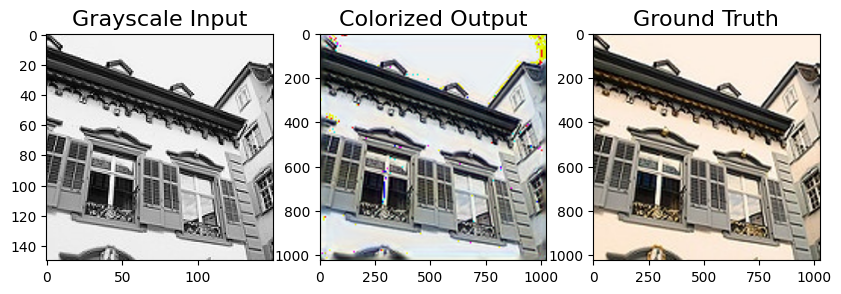

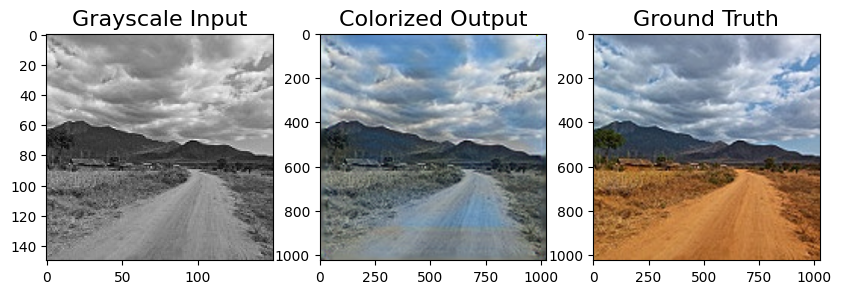

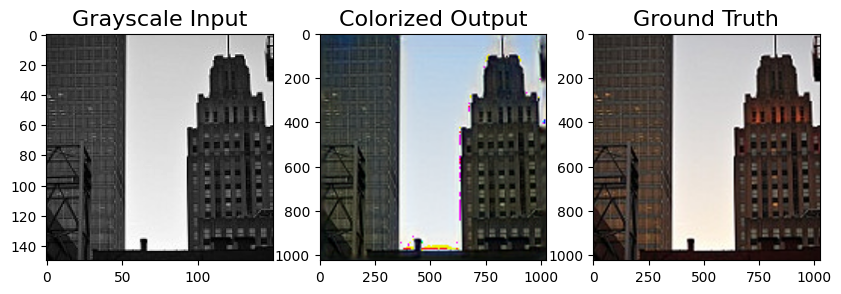

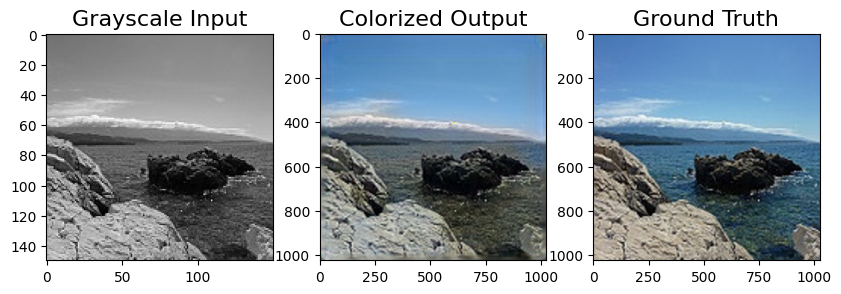

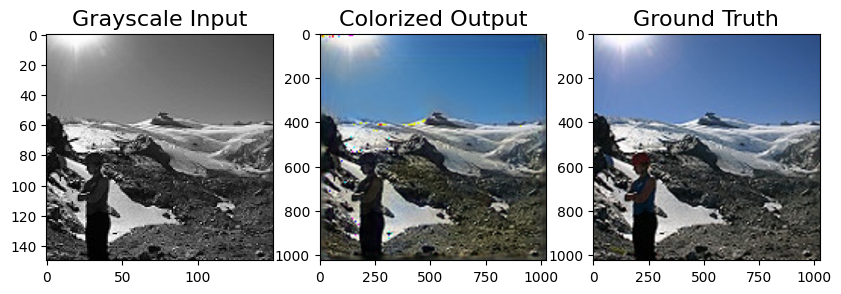

...

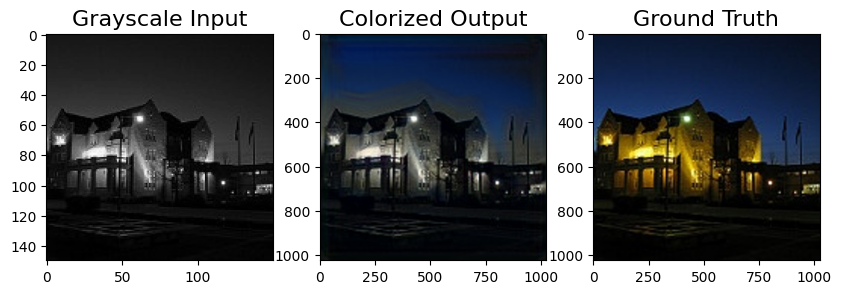

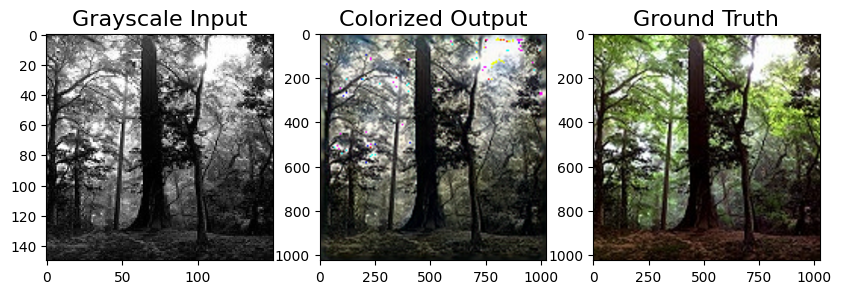

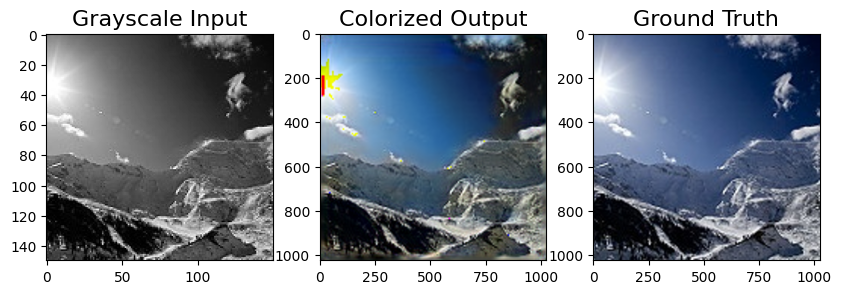

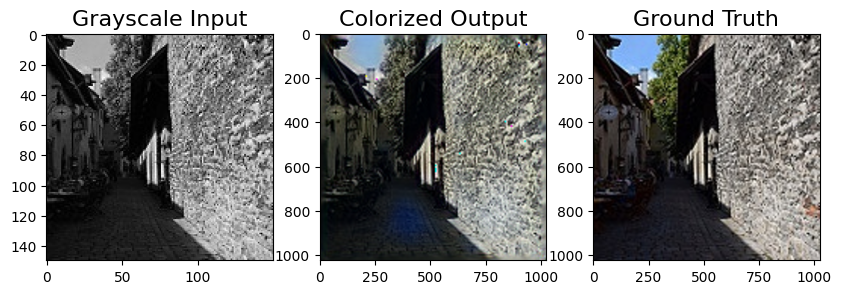

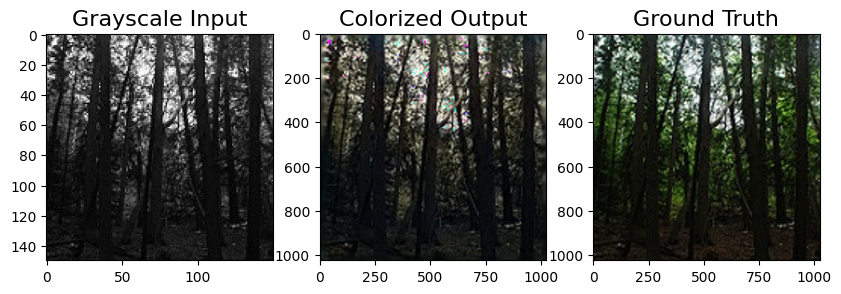

In [43]:
from matplotlib import image
from matplotlib import pyplot as plt
for i in range(len(test_x)):
  plt.figure(figsize=(10,10))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Grayscale Input', fontsize=16)
  plt.imshow( test_x[i].reshape((150,150)) , cmap='gray' )

  in_image = plt.subplot(3,3,2)
  image = Image.fromarray( ( y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  image = np.asarray( image )
  in_image.set_title('Colorized Output', fontsize=16)
  plt.imshow( image )

  ou_image = plt.subplot(3,3,3)
  image = Image.fromarray( ( test_y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  ou_image.set_title('Ground Truth', fontsize=16)
  plt.imshow( image )

  plt.show()

In [45]:
# trying on random image => 1000th image in the data set

main_add = 'drive/MyDrive/data/data'
img_size = 150
x_testing = []
y_testing = []
for image_file in os.listdir( main_add )[ 1000 : 10001]:
    rgb_image = Image.open( os.path.join( main_add , image_file ) ).resize( ( img_size , img_size ) )
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    gray_image = rgb_image.convert( 'L' )
    gray_img_array = ( np.asarray( gray_image ).reshape( ( img_size , img_size , 1 ) ) ) / 255
    x_testing.append( gray_img_array )
    y_testing.append( rgb_img_array )


In [ ]:
y = generator( x_testing[0 : ] ).numpy()

In [ ]:
from matplotlib import image
from matplotlib import pyplot as plt
for i in range(len(test_x)):
  plt.figure(figsize=(10,10))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Grayscale Input', fontsize=16)
  plt.imshow( test_x[i].reshape((150,150)) , cmap='gray' )

  in_image = plt.subplot(3,3,2)
  image = Image.fromarray( ( y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  image = np.asarray( image )
  in_image.set_title('Colorized Output', fontsize=16)
  plt.imshow( image )

  ou_image = plt.subplot(3,3,3)
  image = Image.fromarray( ( test_y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  ou_image.set_title('Ground Truth', fontsize=16)
  plt.imshow( image )

  plt.show()